## Using sigma(...)

This notebook demonstrates how to use the `sigma(...)` function to compare spectra on a channel-by-channel basis.  When a spectrum is very similar to the other spectra in a collection, the result will be a `sigma(spec,specs,roc)` that is very close to a Normal distribution with a width of 1 and a center of zero.  This demonstrates that count statistics are the only source of variation.

The spectra in this example are extremely similar.  This suggests that K412 is extremely homogeneous and the measurements were taken carefully.

In brief, the `sigma(specs[1],specs,1:2000)` function, calculates the mean spectrum (except for `specs[1]`) over the range of channels 1:2000.  It then calculates the difference of `specs[1]` from the mean and divides this by the uncertainty from count statistics alone.

In [1]:
using NeXLSpectrum
using StatsBase
using Distributions
using Gadfly

┌ Info: Loading Gadfly support into NeXLSpectrum.
└ @ NeXLSpectrum C:\Users\nritchie\.julia\dev\NeXLSpectrum\src\gadflysupport.jl:564


In [2]:
path = joinpath(@__DIR__,"..","test","K412 Spectra")
specs = loadspectrum.(joinpath(path,"III-E K412[$i][4].msa") for i in 0:4)

5-element Vector{Spectrum{Float64}}:
 Spectrum{Float64}[III-E K412[0][all], E[ch] = 1.63032 + 9.99856⋅ch, 4096 ch, 20.0 keV, K412, 8.08e6 counts]
 Spectrum{Float64}[III-E K412[1][all], E[ch] = 1.63032 + 9.99856⋅ch, 4096 ch, 20.0 keV, K412, 8.08e6 counts]
 Spectrum{Float64}[III-E K412[2][all], E[ch] = 1.63032 + 9.99856⋅ch, 4096 ch, 20.0 keV, K412, 8.08e6 counts]
 Spectrum{Float64}[III-E K412[3][all], E[ch] = 1.63032 + 9.99856⋅ch, 4096 ch, 20.0 keV, K412, 8.09e6 counts]
 Spectrum{Float64}[III-E K412[4][all], E[ch] = 1.63032 + 9.99856⋅ch, 4096 ch, 20.0 keV, K412, 8.08e6 counts]

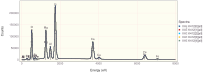

In [3]:
set_default_plot_size(8inch, 3inch)
plot(specs..., autoklms=true, xmax=8.0e3)

In [4]:
set_default_plot_size(6inch,12inch)
ss = [ sigma(specs[i],specs,1:2000) for i in eachindex(specs) ]
vstack( ( plot(x=eachindex(ss[i]),y=ss[i],Geom.point) for i in eachindex(ss) )...)

In [5]:
ns = fit.(Normal,ss)

5-element Vector{Normal{Float64}}:
 Normal{Float64}(μ=-0.05240393674216127, σ=1.007067008078397)
 Normal{Float64}(μ=-0.027119530723808044, σ=1.041984443770841)
 Normal{Float64}(μ=0.009007946333091951, σ=1.0292404078443032)
 Normal{Float64}(μ=0.10682539677607662, σ=0.9928960610298465)
 Normal{Float64}(μ=0.11115156896689808, σ=0.9856331007227486)

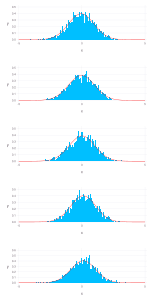

In [6]:
set_default_plot_size(6inch, 12inch)
vstack( ( plot(
  layer(x=-5.0:0.1:5.0, y=pdf.(ns[i],(-5.0:0.1:5.0)), Geom.line, Theme(default_color="red")),
  layer(x=ss[i], Geom.histogram(bincount=100,density=true))
  ) for i in eachindex(ss) )...)